In [2]:
%matplotlib inline

from matplotlib import pyplot as plt
import pandas as pd
import cv2

df = pd.DataFrame(columns=['image', 'corners', 'm', 'c', 'corners_m', 'corners_c'])
df

,image,corners,m,c,corners_m,corners_c


## Pre-Processing

### 1. Croping

In [3]:
from os.path import isfile, join
from os import listdir

mypath='resep_imdi'
onlyfiles = [ f for f in listdir(mypath) if isfile(join(mypath,f)) ]
df['image'] = df['image'].astype(object)
for n in range(0,len(onlyfiles)):
    path = join(mypath,onlyfiles[n])
    df.set_value(n, 'image', path)

#### Visualization

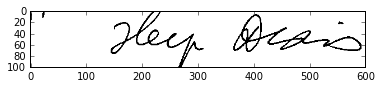

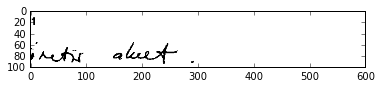

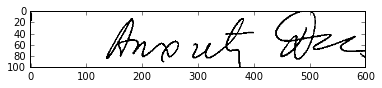

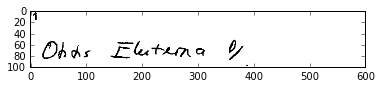

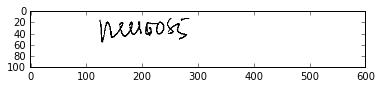

...

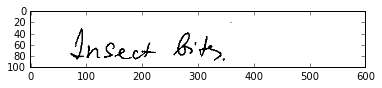

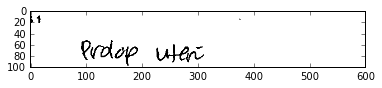

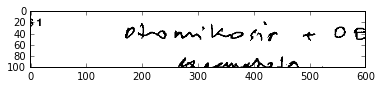

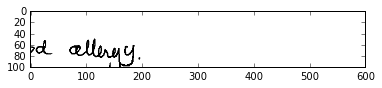

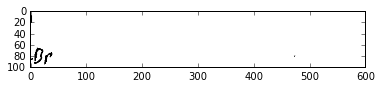

In [3]:
# VISUALIZATION
for path in df['image']:
    img = cv2.imread(path)
    img = img[375:475, 1400:2000] # Crop from y1:y2, x1:x2
    
    plt.imshow(img)
    plt.show()

## Features Extraction

### 1. Corners Detection

In [4]:
from numpy.polynomial import Polynomial
import numpy as np

for index, data in df.iterrows():
    img = cv2.imread(data['image'])
    img = img[375:475, 1400:2000] # Crop from y1:y2, x1:x2
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    corners = cv2.goodFeaturesToTrack(gray_img,25,0.01,10)
    corners = np.int0(corners)
    df.set_value(index, 'corners', corners)
    
    print data['image'], 'has', len(corners), 'corner'

resep_imdi/d andrean xavemo (3628) - 0070.tif has 25 corner
resep_imdi/dr dyah I (3720) - 0070.tif has 25 corner
resep_imdi/d andrean xavemo (3628) - 0059.tif has 25 corner
resep_imdi/dr dyah I (3720) - 0067.tif has 25 corner
resep_imdi/dr agung budi setyawan (3061) - 0048.tif has 25 corner
resep_imdi/dr andi budi herianto (3767) - 0075.tif has 25 corner
resep_imdi/d andrean xavemo (3628) - 0053.tif has 25 corner
resep_imdi/dr dyah I (3720) - 0007.tif has 25 corner
resep_imdi/dr diar mia ardiani (3691) - 0025.tif has 25 corner
resep_imdi/dr ellen sidowati (3686) - 0023.tif has 25 corner
resep_imdi/dr abdi bumi suryanto (3587) - 0011.tif has 25 corner
resep_imdi/dr diana tri ratnasari (3700) - 0013.tif has 25 corner
resep_imdi/dr dyah I (3720) - 0028.tif has 25 corner
resep_imdi/dr diana tri ratnasari (3700) - 0019.tif has 25 corner
resep_imdi/dr daniel t suryadisastra (3215) - 0023.tif has 25 corner
resep_imdi/dr diana tri ratnasari (3700) - 0008.tif has 25 corner
resep_imdi/dr diar mi

#### Visualization

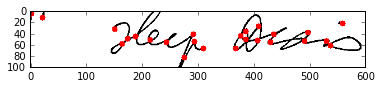

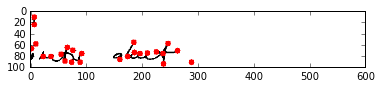

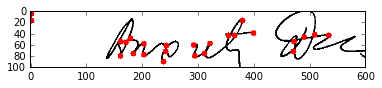

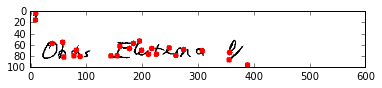

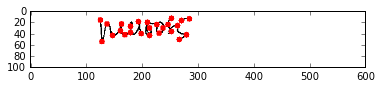

...

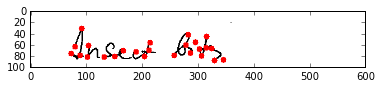

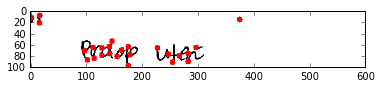

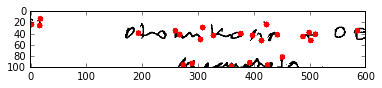

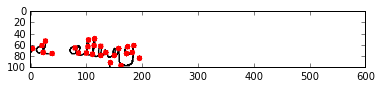

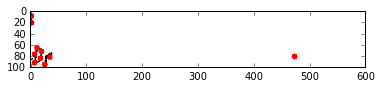

In [8]:
# VISUALIZATION
for index, data in df.iterrows():
    img = cv2.imread(data['image'])
    img = img[375:475, 1400:2000] # Crop from y1:y2, x1:x2
    height, width = img.shape[:2]
    
    for i in data['corners']:
        x,y = i.ravel()
        cv2.circle(img,(x,y), thickness=5, 255, -1)
    plt.imshow(img)
    plt.show()
    print data['image']

### 2. Liniear Regression

In [5]:
for index,data in df.iterrows():
    xi =[]
    yi = []
    for i in data['corners']:
        x,y = i.ravel()
        xi += [x]
        yi += [y]
        
    m,c = np.polyfit(xi, yi, 1)
    df.set_value(index, 'm', m)
    df.set_value(index, 'c', c)
    
    print data['image']
    print 'y =',data['c'],'+',str(data['m'])+'x'
    print ''

resep_imdi/d andrean xavemo (3628) - 0070.tif
y = 36.121080425 + 0.0332233558179x

resep_imdi/dr dyah I (3720) - 0070.tif
y = 62.5756100013 + 0.0719082475729x

resep_imdi/d andrean xavemo (3628) - 0059.tif
y = 52.4906370263 + 0.00985840757394x

resep_imdi/dr dyah I (3720) - 0067.tif
y = 48.8922689976 + 0.103056534612x

resep_imdi/dr agung budi setyawan (3061) - 0048.tif
y = 40.1356913454 + -0.0403127579299x

resep_imdi/dr andi budi herianto (3767) - 0075.tif
y = 47.3602893944 + 0.053522717617x

resep_imdi/d andrean xavemo (3628) - 0053.tif
y = 22.1175596786 + 0.0677788723104x

resep_imdi/dr dyah I (3720) - 0007.tif
y = 71.4745147229 + 0.0265276510692x

resep_imdi/dr diar mia ardiani (3691) - 0025.tif
y = 35.9525815564 + 0.0715703960649x

resep_imdi/dr ellen sidowati (3686) - 0023.tif
y = 67.7413844509 + 0.0442998355403x

resep_imdi/dr abdi bumi suryanto (3587) - 0011.tif
y = 34.6639310132 + 0.0560339452246x

resep_imdi/dr diana tri ratnasari (3700) - 0013.tif
y = 88.6751735505 + -0.003

/usr/lib/python2.7/dist-packages/numpy/lib/polynomial.py:587: RankWarning: Polyfit may be poorly conditioned
  warnings.warn(msg, RankWarning)
/usr/lib/python2.7/dist-packages/numpy/lib/polynomial.py:587: RankWarning: Polyfit may be poorly conditioned
  warnings.warn(msg, RankWarning)


0.0361281032084x

resep_imdi/d andrean xavemo (3628) - 0094.tif
y = 62.2335926518 + -0.00786740757671x

resep_imdi/dr abdi bumi suryanto (3587) - 0082.tif
y = 26.8891459252 + 0.0419722161234x

resep_imdi/dr dyah I (3720) - 0065.tif
y = 52.283931383 + 0.0373937211458x

resep_imdi/dr agung budi setyawan (3061) - 0055.tif
y = 53.9806541276 + -0.0557524528271x

resep_imdi/dr ellen sidowati (3686) - 0013.tif
y = 61.4063408592 + 0.0259631119485x

resep_imdi/dr diar mia ardiani (3691) - 0006.tif
y = 59.8910947287 + 0.0165257078252x

resep_imdi/dr andi budi herianto (3767) - 0002.tif
y = 128.143943759 + -0.189120663824x

resep_imdi/dr dyah I (3720) - 0074.tif
y = 50.4994861254 + 0.132900822199x

resep_imdi/dr diar mia ardiani (3691) - 0053.tif
y = 40.1830954719 + 0.123712997767x

resep_imdi/d andrean xavemo (3628) - 0066.tif
y = 35.546459175 + 0.104609197399x

resep_imdi/dr dyah I (3720) - 0009.tif
y = 68.1785860091 + 0.0309523140078x

resep_imdi/dr ellen sidowati (3686) - 0008.tif
y = 59.2940

#### Visualization

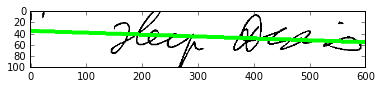

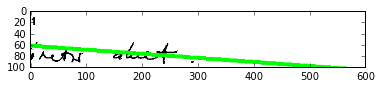

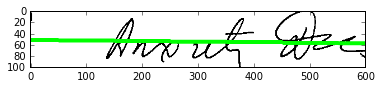

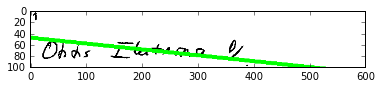

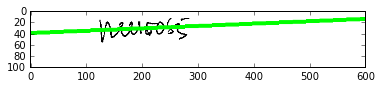

...

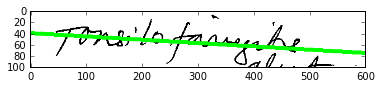

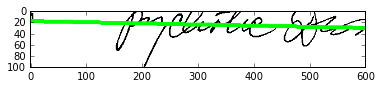

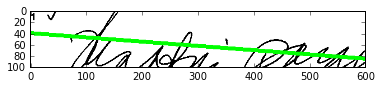

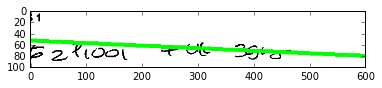

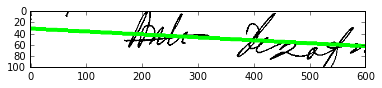

In [11]:
# VISUALIZATION
for index,data in df.iterrows():
    img = cv2.imread(data['image'])
    img = img[375:475, 1400:2000] # Crop from y1:y2, x1:x2
    height, width = img.shape[:2]
    
    y = lambda x: int(data['c']+data['m']*x)
    result = cv2.line(img, (0,y(0)), (width, y(width)), color=(0,255,0), thickness=5)
    # result = cv2.polylines(result, p.linspace()[0], False, color=(0,255,0), thickness=10*(width/height))
    plt.imshow(result)
    plt.show()
    print 'y =',data['c'],'+',str(data['m'])+'x'

### 3. Perpendicular Line (ToDo)

## Clustering

http://scikit-learn.org/stable/auto_examples/cluster/plot_mean_shift.html#example-cluster-plot-mean-shift-py

http://stackoverflow.com/questions/29934083/linear-regression-on-pandas-dataframe-using-sci-kit-learn

https://pypi.python.org/pypi/sklearn-pandas

### 1. Mean Shift

In [13]:
from sklearn.cluster import MeanShift, estimate_bandwidth
from sklearn.datasets.samples_generator import make_blobs

X = df[['m','c']].values
X = X.reshape(len(X),2)

# The following bandwidth can be automatically detected using
bandwidth = estimate_bandwidth(X, quantile=0.3, n_samples=len(X))

ms = MeanShift(bandwidth=bandwidth, bin_seeding=True)
ms.fit(X)
labels = ms.labels_
cluster_centers = ms.cluster_centers_

labels_unique = np.unique(labels)
n_clusters_ = len(labels_unique)

print("number of estimated clusters : %d" % n_clusters_)

number of estimated clusters : 5


#### Visualization

In [14]:
import matplotlib.pyplot as plt
from itertools import cycle

plt.figure(1)
plt.clf()

colors = cycle('bgrcmykbgrcmykbgrcmykbgrcmyk')
for k, col in zip(range(n_clusters_), colors):   
    my_members = labels == k
    cluster_center = cluster_centers[k]
#     print X[my_members, 1]
    plt.plot(X[my_members, 0], X[my_members, 1], col + '.')
    plt.plot(cluster_center[0], cluster_center[1], 'o', markerfacecolor=col,
             markeredgecolor='k', markersize=14)
plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()